In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
#!git clone https://github.com/mandrakedrink/ChestCTSegmentation

#pip install albumentations==0.4.6
#!pip install git+https://github.com/qubvel/segmentation_models.pytorch

import sys

# Add module in system path
sys.path.append("ChestCTSegmentation")

In [3]:
#from google.colab import drive
#drive.mount('/content/drive')

In [4]:
#!unzip -q '/content/drive/My Drive/ct_chest_seg/images.zip'
#!unzip -q '/content/drive/My Drive/ct_chest_seg/masks.zip'

In [14]:
import time
import os

import torch
import numpy as np
import pandas as pd

from train import Trainer
from loss_metric import BCEDiceLoss


In [15]:
from segmentation_models_pytorch import Unet

In [16]:
from IPython.display import clear_output
import warnings
warnings.simplefilter("ignore")

In [9]:
#!conda install pytorch==1.7.0 torchvision==0.8.0 torchaudio==0.7.0 cudatoolkit=10.2 -c pytorch

In [6]:
class GlobalConfig:
    def __init__(self):
        self.seed = 555
        self.path_to_csv = 'C:\conda\onlab/train_mini.csv'
        self.path_to_imgs_dir = 'C:\conda\onlab/images'
        self.path_to_masks_dir = 'C:\conda\onlab/masks'
        self.pretrained_model_path = 'C:\conda\onlab/pretrained_model/model_100_epoch.pth'
        self.train_logs_path = 'C:\conda\onlab/pretrained_model/train_log_100_epoch.csv'


def seed_everything(seed: int):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    
config = GlobalConfig()
seed_everything(config.seed)

In [7]:
model = Unet('efficientnet-b2', encoder_weights="imagenet", classes=3, activation=None)

# Train Process

In [12]:
trainer = Trainer(net=model,
                  criterion=BCEDiceLoss(),
                  lr=8e-5,
                  accumulation_steps=32,
                  batch_size=8,
                  num_epochs=1,
                  imgs_dir = config.path_to_imgs_dir,
                  masks_dir = config.path_to_masks_dir,
                  path_to_csv = config.path_to_csv,)

if config.pretrained_model_path is not None:
    trainer.load_predtrain_model(config.pretrained_model_path)
    
    # if need - load the logs.      
    train_logs = pd.read_csv(config.train_logs_path)
    trainer.losses["train"] =  train_logs.loc[:, "train_loss"].to_list()
    trainer.losses["val"] =  train_logs.loc[:, "val_loss"].to_list()
    trainer.dice_scores["train"] = train_logs.loc[:, "train_dice"].to_list()
    trainer.dice_scores["val"] = train_logs.loc[:, "val_dice"].to_list()
    trainer.jaccard_scores["train"] = train_logs.loc[:, "train_jaccard"].to_list()
    trainer.jaccard_scores["val"] = train_logs.loc[:, "val_jaccard"].to_list()

device: cuda
Predtrain model loaded


In [17]:
import cv2
teeeszt = cv2.imread("C:\conda\onlab/masks\ID00400637202305055099402_mask_66.jpg")
print(type(teeeszt))

<class 'numpy.ndarray'>


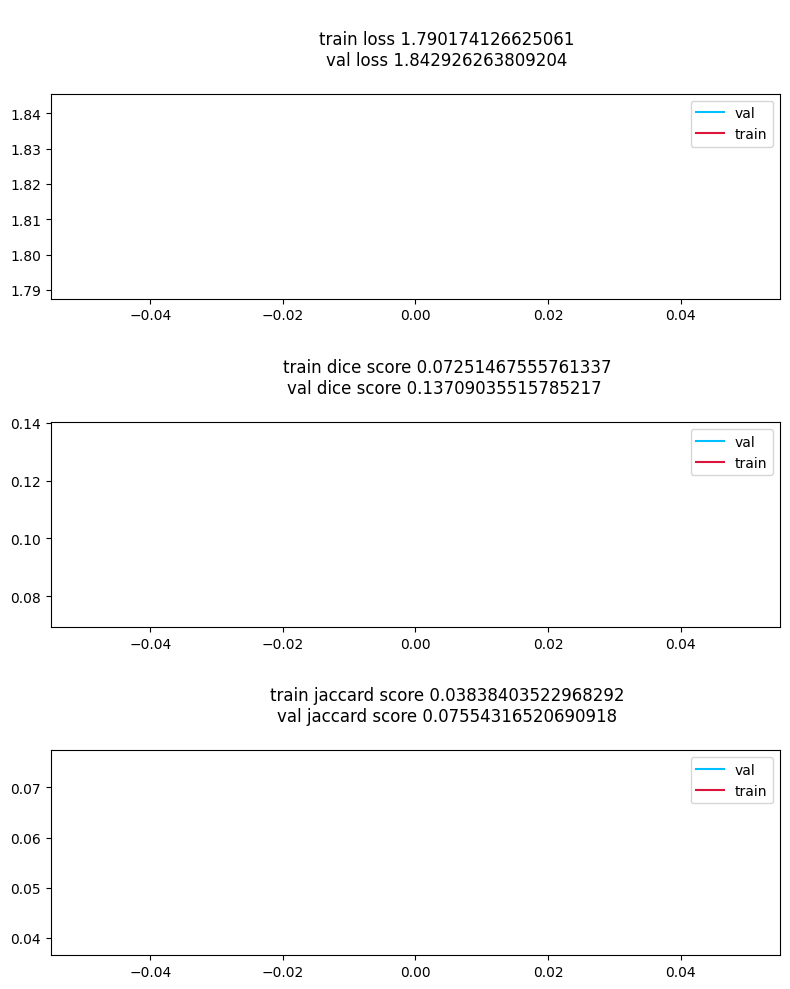


####################
Saved new checkpoint
####################


CPU times: total: 3min 27s
Wall time: 3min 37s


In [22]:
%%time
trainer.train()

# Experiments and Results

In [9]:
from dataset_dataloader  import get_dataloader
from utils import compute_scores_per_classes

import matplotlib.pyplot as plt
import seaborn as sns

In [10]:
val_dataloader = get_dataloader(
    imgs_dir=config.path_to_imgs_dir,
    masks_dir=config.path_to_masks_dir,
    path_to_csv=config.path_to_csv,
    phase = "val",
    batch_size = 8,
    num_workers = 6,
    test_size = 0.2,
)

In [25]:
%%time
dice_scores_per_classes, iou_scores_per_classes = compute_scores_per_classes(
    model, val_dataloader, ['lung', 'heart', 'trachea']
    )

CPU times: total: 10.8 s
Wall time: 17 s


In [26]:
dice_df = pd.DataFrame(dice_scores_per_classes)
dice_df.columns = ['lung dice', 'heart dice', 'trachea dice']

iou_df = pd.DataFrame(iou_scores_per_classes)
iou_df.columns = ['lung jaccard', 'heart jaccard', 'trachea jaccard']
val_metics_df = pd.concat([dice_df, iou_df], axis=1, sort=True)
val_metics_df = val_metics_df.loc[:, ['lung dice', 'lung jaccard', 
                                      'heart dice', 'heart jaccard', 
                                      'trachea dice', 'trachea jaccard']]
val_metics_df

,lung dice,lung jaccard,heart dice,heart jaccard,trachea dice,trachea jaccard
0,0.325999,0.194742,6.851145e-15,6.851145e-15,1.029866e-12,1.029866e-12
1,0.223479,0.125796,6.161800e-02,3.178837e-02,5.586592e-12,5.586592e-12
2,0.329480,0.197232,1.037104e-02,5.212548e-03,1.841621e-12,1.841621e-12
3,0.031003,0.015746,7.191037e-15,7.191037e-15,6.060606e-12,6.060606e-12
4,0.073723,0.038272,7.422307e-15,7.422307e-15,4.608295e-12,4.608295e-12
5,0.299852,0.176368,1.002905e-01,5.279256e-02,6.410256e-12,6.410256e-12


NameError: name 'val_metics_df' is not defined

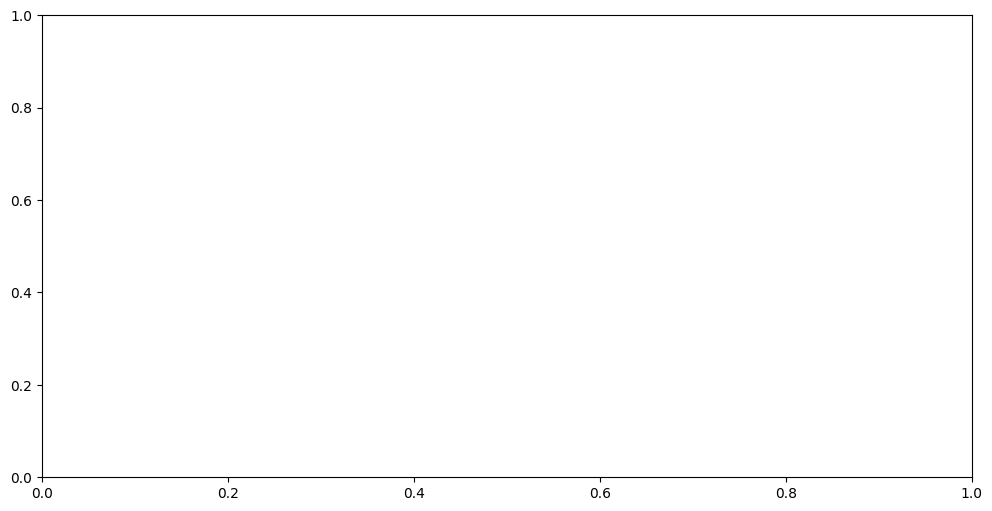

In [11]:
%matplotlib inline
colors = ['#35FCFF', '#FF355A', '#96C503', '#C5035B', '#28B463', '#35FFAF']
palette = sns.color_palette(colors, 6)

fig, ax = plt.subplots(figsize=(12, 6));
sns.barplot(x=val_metics_df.mean().index, y=val_metics_df.mean(), palette=palette, ax=ax);
ax.set_xticklabels(val_metics_df.columns, fontsize=14, rotation=15);
ax.set_title("Dice and Jaccard Coefficients from Validation", fontsize=20)

for idx, p in enumerate(ax.patches):
        percentage = '{:.1f}%'.format(100 * val_metics_df.mean().values[idx])
        x = p.get_x() + p.get_width() / 2 - 0.15
        y = p.get_y() + p.get_height()
        ax.annotate(percentage, (x, y), fontsize=15, fontweight="bold")

fig.savefig("result1.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')
fig.savefig("result1.svg", format="svg",  pad_inches=0.2, transparent=False, bbox_inches='tight')

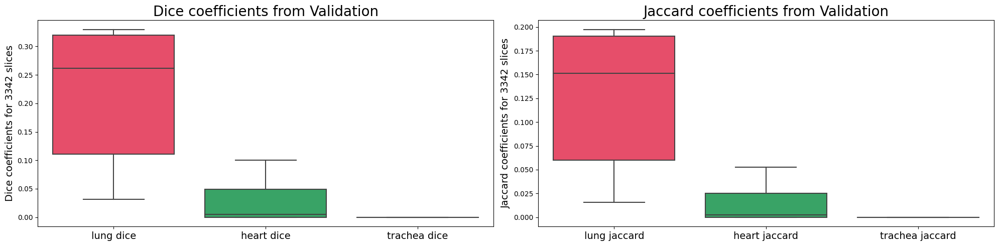

In [35]:
colors = ['#35FCFF', '#FF355A', '#28B463', '#35FFAF', '#96C503', '#C5035B']
palette = sns.color_palette(colors[1::], 3)

fig, ax = plt.subplots(1, 2, figsize=(20, 5))
sns.boxplot(data=dice_df, palette=palette, ax=ax[0])
ax[0].set_ylabel("Dice coefficients for 3342 slices", fontsize=14)
ax[0].set_title("Dice coefficients from Validation", fontsize=20)
ax[0].set_xticklabels(dice_df.columns, fontsize=14)

sns.boxplot(data=iou_df, palette=palette, ax=ax[1])
ax[1].set_ylabel("Jaccard coefficients for 3342 slices", fontsize=14)
ax[1].set_title("Jaccard coefficients from Validation", fontsize=20)
ax[1].set_xticklabels(iou_df.columns, fontsize=14)
plt.tight_layout()

fig.savefig("result2.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')
fig.savefig("result2.svg", format="svg",  pad_inches=0.2, transparent=False, bbox_inches='tight')

and train history logs 

In [36]:
train_logs = pd.read_csv(config.train_logs_path)
train_logs.head(5)

,train_loss,val_loss,train_dice,val_dice,train_jaccard,val_jaccard
0,0.386394,0.176678,0.697667,0.755589,0.646303,0.717975
1,0.144522,0.123104,0.769935,0.786307,0.731782,0.752826
2,0.112448,0.093943,0.811846,0.829476,0.775296,0.795960
3,0.087972,0.073344,0.838840,0.851835,0.804823,0.819167
4,0.073297,0.064866,0.854065,0.861600,0.821115,0.830928


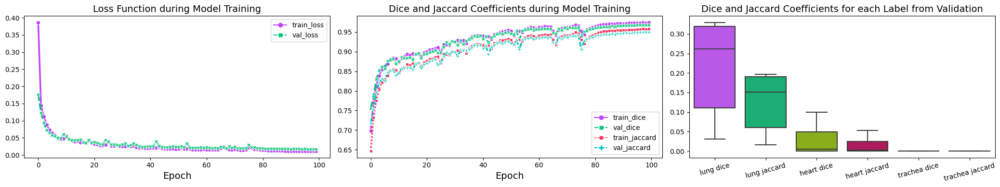

In [37]:
colors = ['#C042FF', '#03C576FF', '#FF355A', '#03C5BF', '#96C503', '#C5035B']
palettes = [sns.color_palette(colors, 2),
            sns.color_palette(colors, 4), 
            sns.color_palette(colors[:2]+colors[-2:] + colors[2:-2], 6)]
            
fig, ax = plt.subplots(1, 3, figsize=(21, 4))

sns.lineplot(data=train_logs.iloc[:, :2], palette=palettes[0], markers=True, ax=ax[0], linewidth=2.5,)
ax[0].set_title("Loss Function during Model Training", fontsize=14)
ax[0].set_xlabel("Epoch", fontsize=14)

sns.lineplot(data=train_logs.iloc[:, 2:], palette=palettes[1], markers=True, ax=ax[1], linewidth=2.5, legend="full")
ax[1].set_title("Dice and Jaccard Coefficients during Model Training", fontsize=14)
ax[1].set_xlabel("Epoch", fontsize=14)

sns.boxplot(data=val_metics_df.iloc[:,:], palette=palettes[2], ax=ax[2])
ax[2].set_title("Dice and Jaccard Coefficients for each Label from Validation", fontsize=14)
ax[2].set_xticklabels(val_metics_df.columns, fontsize=10, rotation=15)

plt.tight_layout()
fig.savefig("result3.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')
fig.savefig("result3.svg", format="svg",  pad_inches=0.2, transparent=False, bbox_inches='tight')

Now let's make a video with overlapped masks for each slice of one id CT 

In [19]:
from utils import (get_one_slice_data, 
                   get_id_predictions, 
                   get_overlaid_masks_on_image,
                   get_overlaid_masks_on_full_ctscan,
                   create_video)
from visualizer import show_video

In [20]:
df = pd.read_csv(config.path_to_csv)
df["Id"] = df['ImageId'].apply(lambda x: x.split("_")[0])

#id_ = 'ID00400637202305055099402'

id_ = 'ID00007637202177411956430'
full_scan_example = df.loc[df['Id'] == id_].reset_index(drop=True)
full_scan_example 

,ImageId,MaskId,Id
0,ID00007637202177411956430_0.jpg,ID00007637202177411956430_mask_0.jpg,ID00007637202177411956430
1,ID00007637202177411956430_1.jpg,ID00007637202177411956430_mask_1.jpg,ID00007637202177411956430
2,ID00007637202177411956430_2.jpg,ID00007637202177411956430_mask_2.jpg,ID00007637202177411956430
3,ID00007637202177411956430_3.jpg,ID00007637202177411956430_mask_3.jpg,ID00007637202177411956430
4,ID00007637202177411956430_4.jpg,ID00007637202177411956430_mask_4.jpg,ID00007637202177411956430
5,ID00007637202177411956430_5.jpg,ID00007637202177411956430_mask_5.jpg,ID00007637202177411956430
6,ID00007637202177411956430_6.jpg,ID00007637202177411956430_mask_6.jpg,ID00007637202177411956430
7,ID00007637202177411956430_7.jpg,ID00007637202177411956430_mask_7.jpg,ID00007637202177411956430
8,ID00007637202177411956430_8.jpg,ID00007637202177411956430_mask_8.jpg,ID00007637202177411956430
9,ID00007637202177411956430_9.jpg,ID00007637202177411956430_mask_9.jpg,ID00007637202177411956430


### Ground Truth

In [52]:
PATH_TO_SAVE = id_ + "_ground_truth"

if not os.path.exists(PATH_TO_SAVE):
    os.mkdir(PATH_TO_SAVE)
    print(f"Folder {PATH_TO_SAVE} created.")

get_overlaid_masks_on_full_ctscan(ct_scan_id_df=full_scan_example,
                                  path_to_save=PATH_TO_SAVE, cimg_path=config.path_to_imgs_dir, cmask_path=config.path_to_masks_dir)

PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_0.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_1.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_2.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_3.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_4.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_5.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_6.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_7.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_8.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_9.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_10.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_11.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_12.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_13.jpg
PATH2: C:\conda\onlab/masks\ID00007637202177411956430_mask_14.jpg
PATH2: C:\conda\onla

In [53]:
%%time
create_video(path_to_imgs=PATH_TO_SAVE, video_name=id_+"_ground_truth", framerate=30)

CPU times: total: 375 ms
Wall time: 451 ms


In [57]:
# to play in google colab had to recode
#https://ottverse.com/ffmpeg-drawtext-filter-dynamic-overlays-timecode-scrolling-text-credits/
!ffmpeg -i 'C:\conda\onlab\ChestCTSegmentation\ID00007637202177411956430_ground_truth.mp4' -vf "drawtext=text='Ground Truth':x=195:y=8:fontsize=24:fontcolor='#FFFFFF'" -strict -2 'transcoded_video1.mp4'

ffmpeg version 2023-10-29-git-2532e832d2-full_build-www.gyan.dev Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 12.2.0 (Rev10, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --pkg-config=pkgconf --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libaribcaption --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-libharfbuzz --e

In [28]:
show_video("transcoded_video1.mp4")

### Prediction

In [21]:
imgs, predictions = get_id_predictions(net=model,
                                       ct_scan_id_df=full_scan_example,
                                       root_imgs_dir=config.path_to_imgs_dir)

device: cuda


In [22]:
%%time
PATH_TO_SAVE = id_ + "_predictions"

if not os.path.exists(PATH_TO_SAVE):
    os.mkdir(PATH_TO_SAVE)
    print(f"Folder {PATH_TO_SAVE} created.")

_= [
    get_overlaid_masks_on_image(one_slice_image=image,
                                one_slice_mask=mask, 
                                write=True,
                                path_to_save=PATH_TO_SAVE,
                                name_to_save= str(i_name)
                                ) 
    for i_name, (image, mask) in enumerate(zip(imgs, predictions))
    ]

Folder ID00007637202177411956430_predictions created.
CPU times: total: 10.9 s
Wall time: 10.9 s


In [31]:
%%time
create_video(path_to_imgs=PATH_TO_SAVE, video_name=id_+"_predictions", framerate=30)

CPU times: user 2.74 s, sys: 63.9 ms, total: 2.81 s
Wall time: 2.81 s


In [ ]:
!ffmpeg -i 'ID00400637202305055099402_predictions.mp4' -vf "drawtext=text='Prediction':x=195:y=8:fontsize=24:fontcolor='#FFFFFF'" -strict -2 'transcoded_video2.mp4'

In [33]:
show_video("transcoded_video2.mp4")

Merging video with ground truth slices and video with predicted slices

In [ ]:
%%shell
#  https://unix.stackexchange.com/questions/233832/merge-two-video-clips-into-one-placing-them-next-to-each-other
ffmpeg \
  -i transcoded_video1.mp4 \
  -i transcoded_video2.mp4 \
  -filter_complex '[0:v]pad=iw*2:ih[int];[int][1:v]overlay=W/2:0[vid]' \
  -map [vid] \
  -c:v libx264 \
  -crf 23 \
  -preset veryfast \
  result.mp4

In [35]:
show_video("result.mp4")